# **YOLOv5 Training**

In [ ]:
!nvidia-smi

Sun Sep 19 20:44:16 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.63.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   42C    P0    27W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
cd /content/drive/MyDrive

/content/drive/MyDrive


In [ ]:
mkdir ScreenCrack

In [ ]:
cd ScreenCrack

/content/drive/My Drive/ScreenCrack


In [ ]:
!git clone https://github.com/ultralytics/yolov5

Cloning into 'yolov5'...
remote: Enumerating objects: 9043, done.
remote: Total 9043 (delta 0), reused 0 (delta 0), pack-reused 9043
Receiving objects: 100% (9043/9043), 9.71 MiB | 12.55 MiB/s, done.
Resolving deltas: 100% (6272/6272), done.


In [ ]:
cd yolov5/

/content/drive/My Drive/ScreenCrack/yolov5


In [ ]:
!pip install -r requirements.txt

     |████████████████████████████████| 636 kB 7.7 MB/s 
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
%%time
import torch


print('\n')
print("=============Summary Stats of GPU/CPU===========\n")
print("Torch Version is       ===>", torch.__version__)
print("Torch built with CUDA? ===>", torch.cuda.is_available())
print("GPU Device Count       ===>", torch.cuda.device_count())
print("GPU-Device Details(arg)===>", torch.cuda.get_device_properties(device=0))



=============Summary Stats of GPU/CPU===========

Torch Version is       ===> 1.9.0+cu102
Torch built with CUDA? ===> True
GPU Device Count       ===> 1
GPU-Device Details(arg)===> _CudaDeviceProperties(name='Tesla P100-PCIE-16GB', major=6, minor=0, total_memory=16280MB, multi_processor_count=56)
CPU times: user 373 ms, sys: 121 ms, total: 494 ms
Wall time: 2.1 s


In [ ]:
!pip install wandb

     |████████████████████████████████| 1.7 MB 8.3 MB/s 
     |████████████████████████████████| 133 kB 53.1 MB/s 
     |████████████████████████████████| 97 kB 8.1 MB/s 
     |████████████████████████████████| 180 kB 47.5 MB/s 
     |████████████████████████████████| 63 kB 2.5 MB/s 
  Created wheel for subprocess32: filename=subprocess32-3.5.4-py3-none-any.whl size=6502 sha256=f0ac272c80a21e1e351999a21472ecc5f607736a4bc84f7c7c00991cd2224c7d
  Stored in directory: /root/.cache/pip/wheels/50/ca/fa/8fca8d246e64f19488d07567547ddec8eb084e8c0d7a59226a
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8807 sha256=f9a6075fdc97f2264719b96deb91bf6ffdc7f9039fb71dd2a9999d3498f9c4d6
  Stored in directory: /root/.cache/pip/wheels/3e/31/09/fa59cef12cdcfecc627b3d24273699f390e71828921b2cbba2
Successfully built subprocess32 pathtools


In [ ]:
import wandb
wandb.login(relogin=True)

<IPython.core.display.Javascript object>

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [ ]:
cd train

/content/drive/MyDrive/ScreenCrack/input_data/images/train


In [ ]:
cd /content/drive/MyDrive/ScreenCrack

/content/drive/MyDrive/ScreenCrack


In [ ]:
!unzip input_data.zip

In [ ]:
cd yolov5


/content/drive/My Drive/ScreenCrack/yolov5


In [ ]:
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [ ]:
pwd

'/content/drive/My Drive/ScreenCrack/yolov5'

In [ ]:
%%writetemplate dataset.yaml

# Train/val/test sets as 1) dir: path/to/imgs, 2) file: path/to/imgs.txt, or 3) list: [path/to/imgs1, path/to/imgs2, ..]
path: ../input_data # dataset root dir
train: images/train  # train images (relative to 'path') 128 images
val: images/train  # val images (relative to 'path') 128 images
test:  # test images (optional)

# Classes Details
nc: 1  # number of classes
names: ["crack"] # Class names

In [ ]:
cat dataset.yaml


# Train/val/test sets as 1) dir: path/to/imgs, 2) file: path/to/imgs.txt, or 3) list: [path/to/imgs1, path/to/imgs2, ..]
path: ../input_data # dataset root dir
train: images/train  # train images (relative to 'path') 128 images
val: images/train  # val images (relative to 'path') 128 images
test:  # test images (optional)

# Classes Details
nc: 1  # number of classes
names: ["crack"] # Class names

In [ ]:
pwd

'/content/drive/MyDrive/ScreenCrack/yolov5'

In [ ]:
!python train.py --img 640 --batch-size 32 --epochs 600 --data dataset.yaml --weights yolov5s.pt --patience 350

100% 755k/755k [00:00<00:00, 19.8MB/s]
wandb: Currently logged in as: abhishekmaity001 (use `wandb login --relogin` to force relogin)
train: weights=yolov5s.pt, cfg=, data=dataset.yaml, hyp=data/hyps/hyp.scratch.yaml, epochs=600, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, adam=False, sync_bn=False, workers=8, project=runs/train, entity=None, name=exp, exist_ok=False, quad=False, linear_lr=False, label_smoothing=0.0, upload_dataset=False, bbox_interval=-1, save_period=-1, artifact_alias=latest, local_rank=-1, freeze=0, patience=350
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v5.0-449-g9ef9494 torch 1.9.0+cu102 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

hyperparameters: lr0=0.01, lrf=0.2, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, c

In [ ]:
### Started training at 3:50 am 

In [ ]:
cd /content/drive/MyDrive/ScreenCrack/yolov5

/content/drive/MyDrive/ScreenCrack/yolov5


In [ ]:
!python detect.py --weights "/content/drive/MyDrive/Screen Crack Detection/yolov5/runs/train/exp/weights/best.pt" --img 640 --conf 0.20 --source "/content/drive/MyDrive/Screen Crack Detection/train_data_final/images/val"


100% 755k/755k [00:00<00:00, 16.2MB/s]
detect: weights=['/content/drive/MyDrive/Screen Crack Detection/yolov5/runs/train/exp/weights/best.pt'], source=/content/drive/MyDrive/Screen Crack Detection/train_data_final/images/val, imgsz=[640, 640], conf_thres=0.2, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False
requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13

requirements: 1 package updated per /content/drive/MyDrive/ScreenCrack/yolov5/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

YOLOv5 🚀 v5.0-4

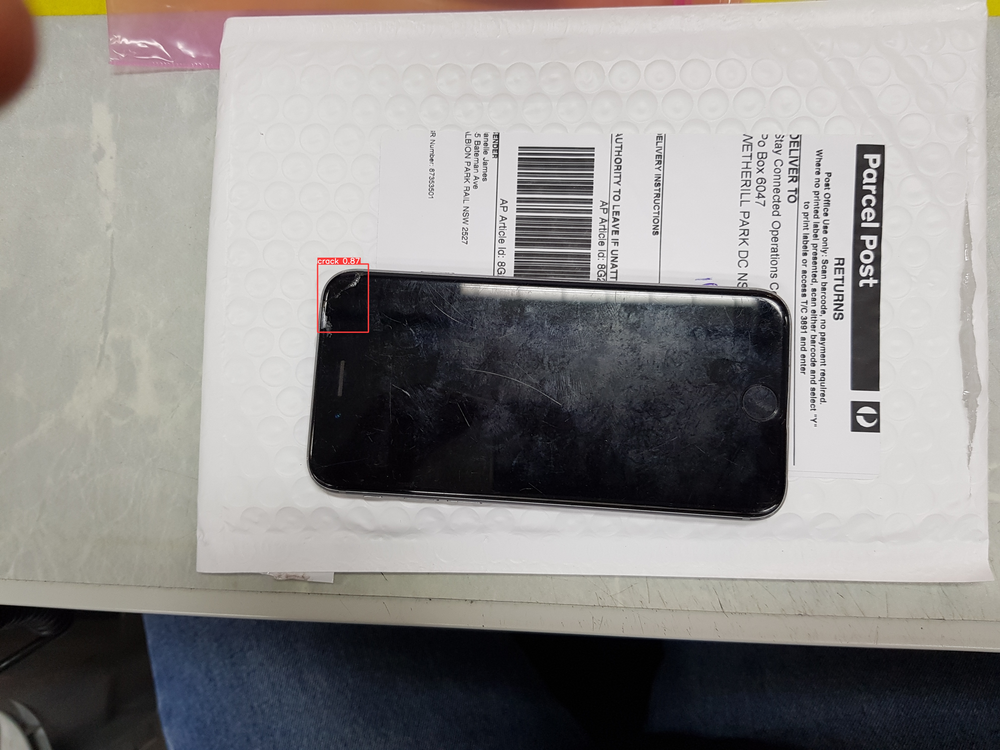

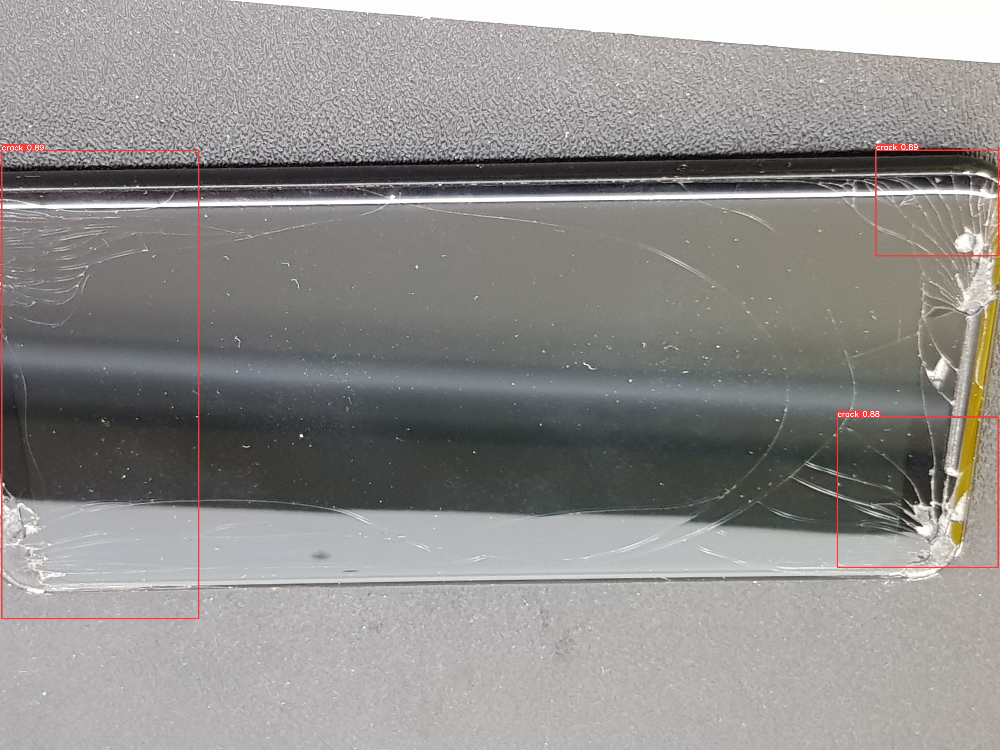

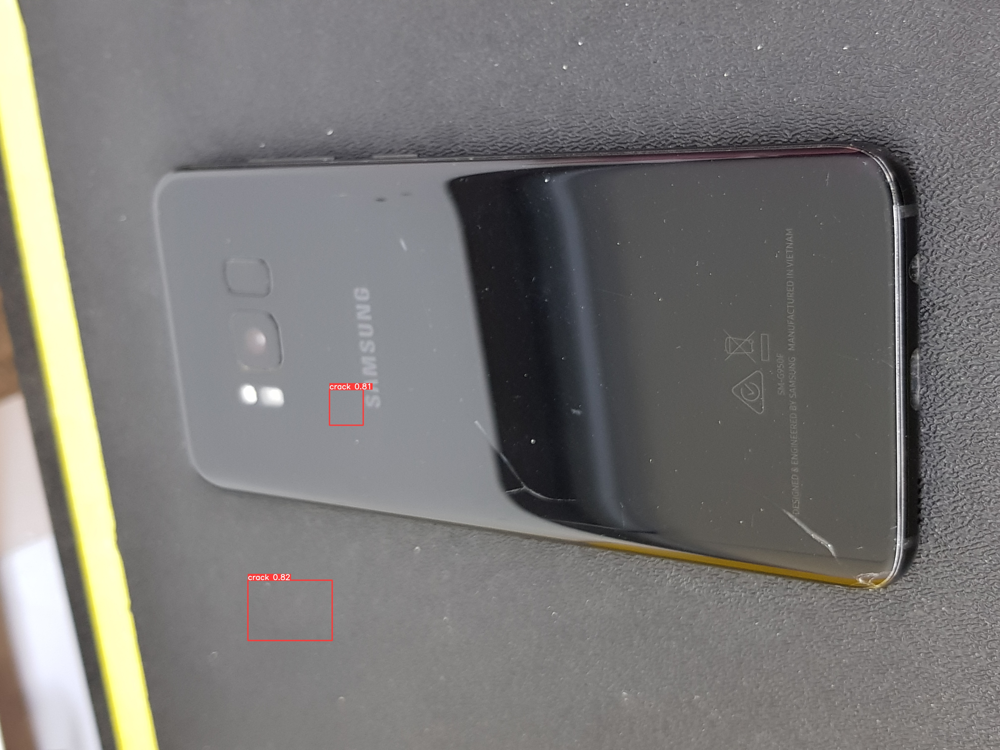

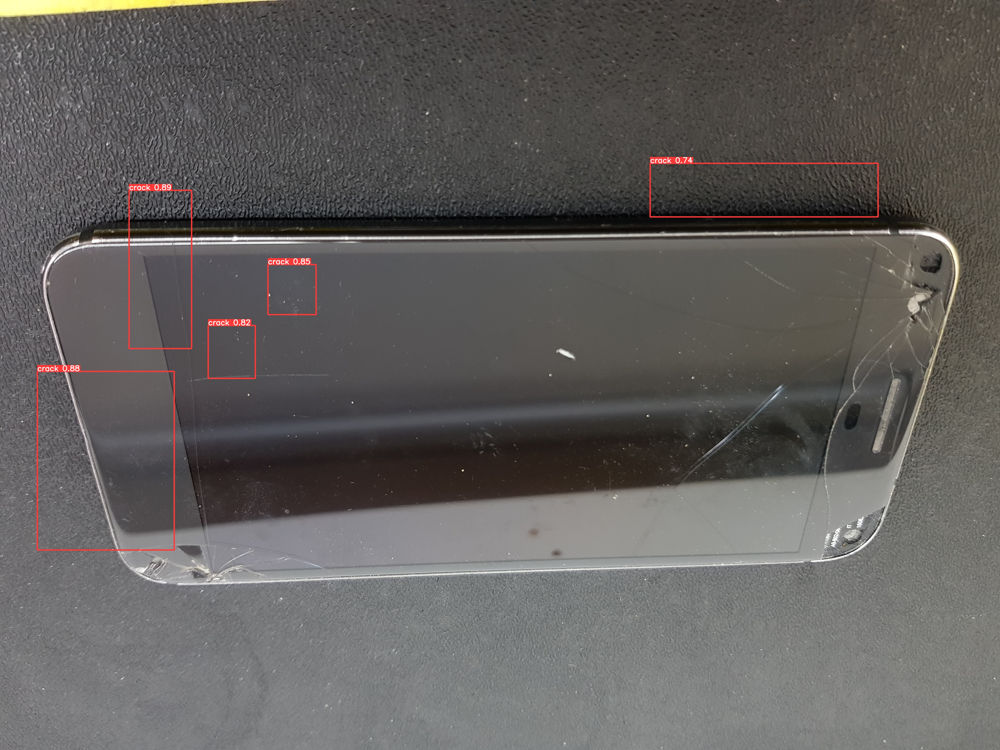

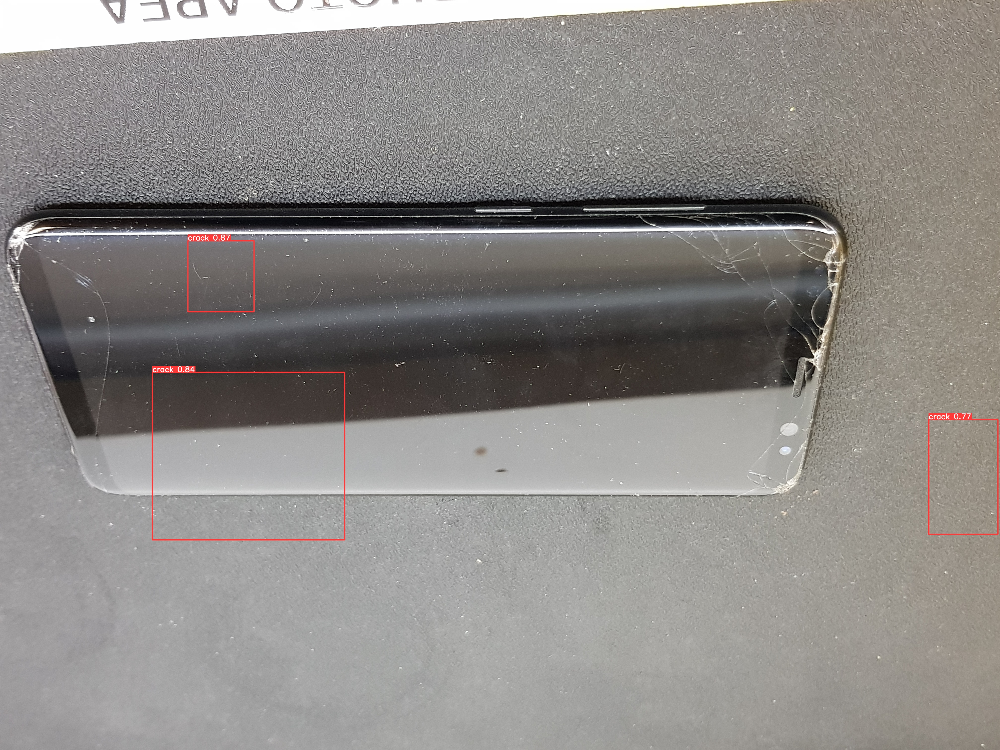

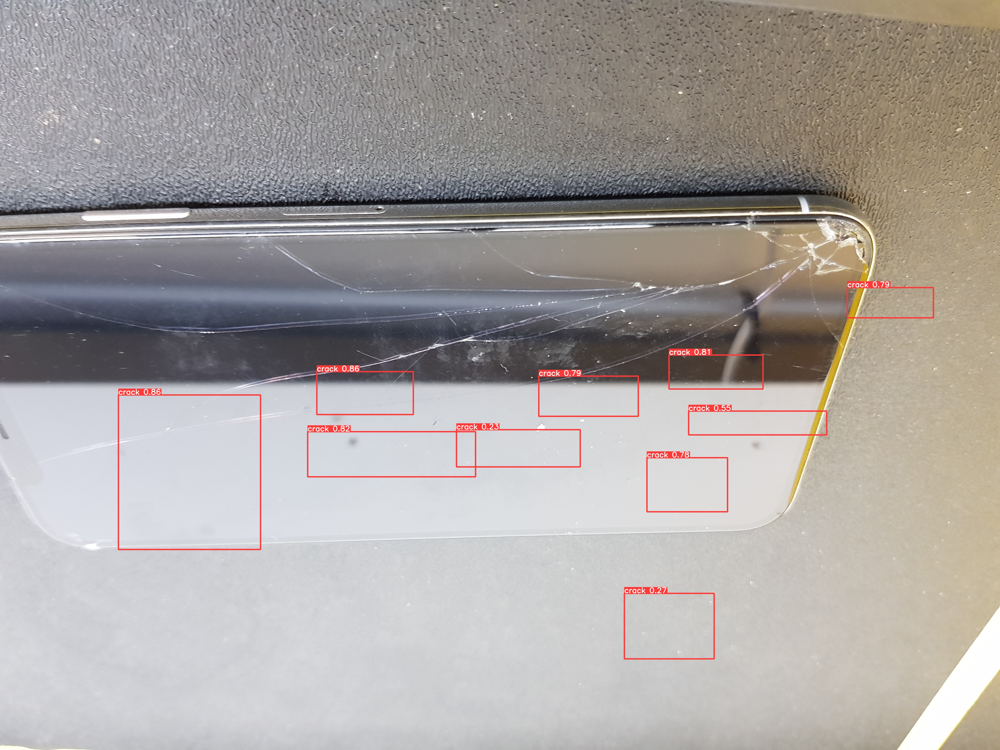

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/drive/MyDrive/ScreenCrack/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName, width=640, height=480))
    print("\n")